<a href="https://colab.research.google.com/github/ruforavishnu/Project_Simulations/blob/main/11th_standard_Physics_Chapter_8_Gravitation_Simulating_Gravitational_Force_between_Two_Masses.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Chapter 8: Gravitation

### Simulating Gravitational Force Between Two Masses

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML



In [ ]:
# Given parameters

G = 6.67430e-11 #Gravitational constant

#Masses (kg)
m1 = 5e10 # Mass 1
m2 = 5e10 # Mass 2


#Initial positions (meters)
pos1 = np.array([-1,0])
pos2 = np.array([1,0])


#Initial velocities (initially zero)
vel1 = np.array([0,0])
vel2 = np.array([0,0])


#Time parameters
dt = 0.01
t_max = 20 #seconds
t = np.arange(0, t_max, dt)


In [ ]:
def compute_force(p1, p2):
  r = np.linalg.norm(p2 - p1)
  force_magnitude = G * m1 * m2 / r**2
  force_direction = (p2 - p1) / r
  force = force_magnitude * force_direction
  return force


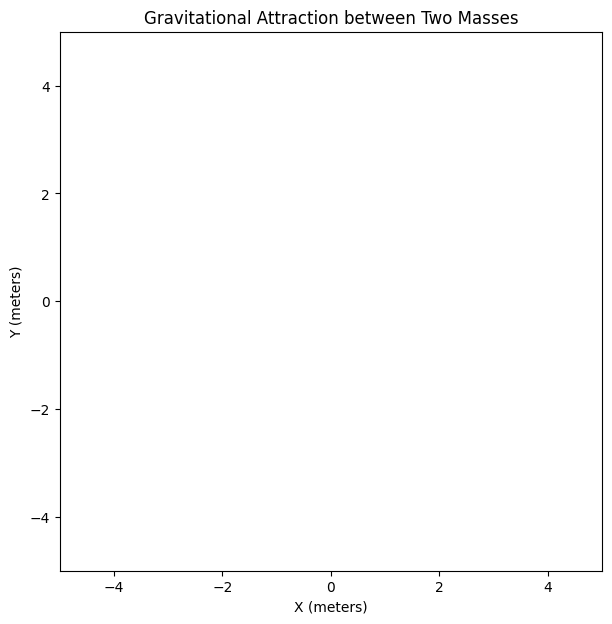

In [ ]:
#create figure and axis

fig, ax = plt.subplots(figsize=(7,7))
ax.set_xlim(-5,5 )
ax.set_ylim(-5, 5)
ax.set_xlabel('X (meters)')
ax.set_ylabel('Y (meters)')
ax.set_title('Gravitational Attraction between Two Masses')

#Draw the masses
mass1_plot, = ax.plot([], [], 'ro', markersize=10)
mass2_plot, = ax.plot([], [], 'bo', markersize=10)


#To store positions
positions1 = []
positions2 = []


#Initialize
def init():
  mass1_plot.set_data([], [])
  mass2_plot.set_data([], [])
  return mass1_plot, mass2_plot

def update(frame):
  global pos1, pos2, vel1, vel2

  #Compute forces
  force_on_1 = compute_force(pos1, pos2)
  force_on_2 = -force_on_1 #Newtons third law

  #Update velocities
  vel1 = vel1.astype(np.float64)
  vel2 = vel2.astype(np.float64)

  vel1 += (force_on_1 / m1) * dt
  vel2 += (force_on_2 / m2) * dt

  #Update positions
  pos1 = pos1.astype(np.float64)
  pos2 = pos2.astype(np.float64)

  pos1 += vel1 * dt
  pos2 += vel2 * dt

  #Update plots
  mass1_plot.set_data([pos1[0]], [pos1[1]])
  mass2_plot.set_data([pos2[0]], [pos2[1]])

  return mass1_plot, mass2_plot


ani = animation.FuncAnimation(fig, update, frames=len(t), init_func=init, blit=True, interval=50)

#Display the animation
HTML(ani.to_jshtml())

